# Data Properties

In [1]:
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt

In [2]:
df = pd.read_csv('train.csv')
df

,ID,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,...,deposit_type,agent,company,days_in_waiting_list,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date
0,0,Resort Hotel,0,342,2015,July,27,1,0,0,...,No Deposit,NaN,NaN,0,Transient,-6.305161,0,0,Check-Out,2015-07-01
1,1,City Hotel,0,257,2015,July,27,1,0,2,...,No Deposit,6.0,NaN,0,Transient,75.052227,0,0,Check-Out,2015-07-03
2,2,City Hotel,0,257,2015,July,27,1,0,2,...,No Deposit,6.0,NaN,0,Transient,74.546401,0,0,Check-Out,2015-07-03
3,3,City Hotel,0,257,2015,July,27,1,0,2,...,No Deposit,6.0,NaN,0,Transient,76.376288,0,0,Check-Out,2015-07-03
4,4,City Hotel,0,257,2015,July,27,1,0,2,...,No Deposit,6.0,NaN,0,Transient,49.411647,0,0,Check-Out,2015-07-03
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
91526,91526,Resort Hotel,1,19,2017,March,13,31,0,2,...,No Deposit,250.0,NaN,0,Transient,79.223571,0,1,Canceled,2017-03-22
91527,91527,Resort Hotel,0,28,2017,March,13,31,0,2,...,No Deposit,NaN,NaN,0,Transient,-6.822102,0,0,Check-Out,2017-04-02
91528,91528,Resort Hotel,0,2,2017,March,13,31,0,1,...,No Deposit,NaN,NaN,0,Transient,90.814554,0,2,Check-Out,2017-04-01
91529,91529,Resort Hotel,0,30,2017,March,13,31,3,7,...,No Deposit,250.0,NaN,0,Transient,38.135565,0,1,Check-Out,2017-04-10


In [3]:
print("# of NaN in each columns:", df.isnull().sum(), sep='\n')

# of NaN in each columns:
ID                                    0
hotel                                 0
is_canceled                           0
lead_time                             0
arrival_date_year                     0
arrival_date_month                    0
arrival_date_week_number              0
arrival_date_day_of_month             0
stays_in_weekend_nights               0
stays_in_week_nights                  0
adults                                0
children                              4
babies                                0
meal                                  0
country                             468
market_segment                        0
distribution_channel                  0
is_repeated_guest                     0
previous_cancellations                0
previous_bookings_not_canceled        0
reserved_room_type                    0
assigned_room_type                    0
booking_changes                       0
deposit_type                          0
agent         

In [4]:
data = df.copy()

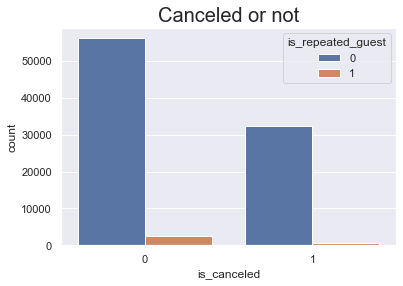

In [5]:
sns.set(style = "darkgrid")
plt.title("Canceled or not", fontdict = {'fontsize': 20})
ax = sns.countplot(x = "is_canceled", hue = 'is_repeated_guest', data = data)

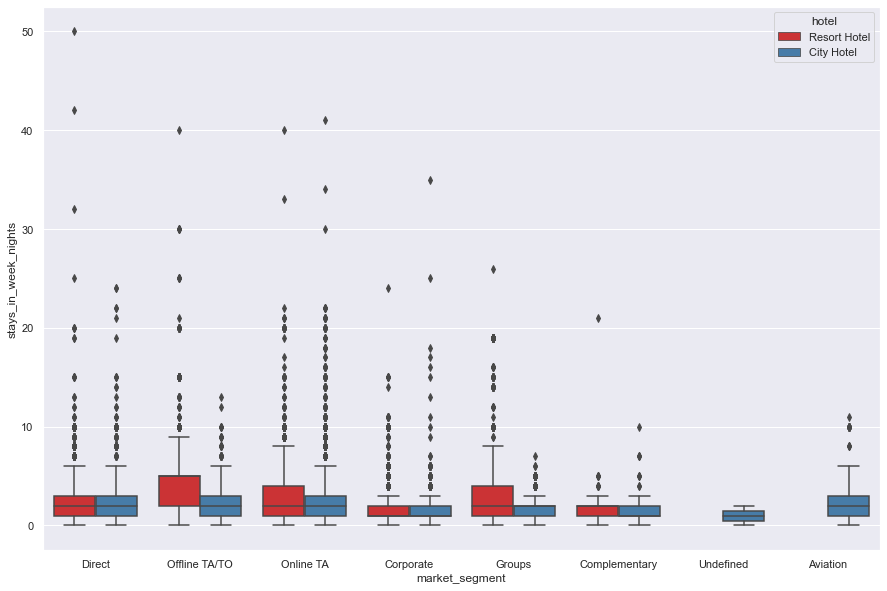

In [6]:
plt.figure(figsize = (15,10))
sns.boxplot(x = "market_segment", y = "stays_in_week_nights", data = data, hue = "hotel", palette = 'Set1')

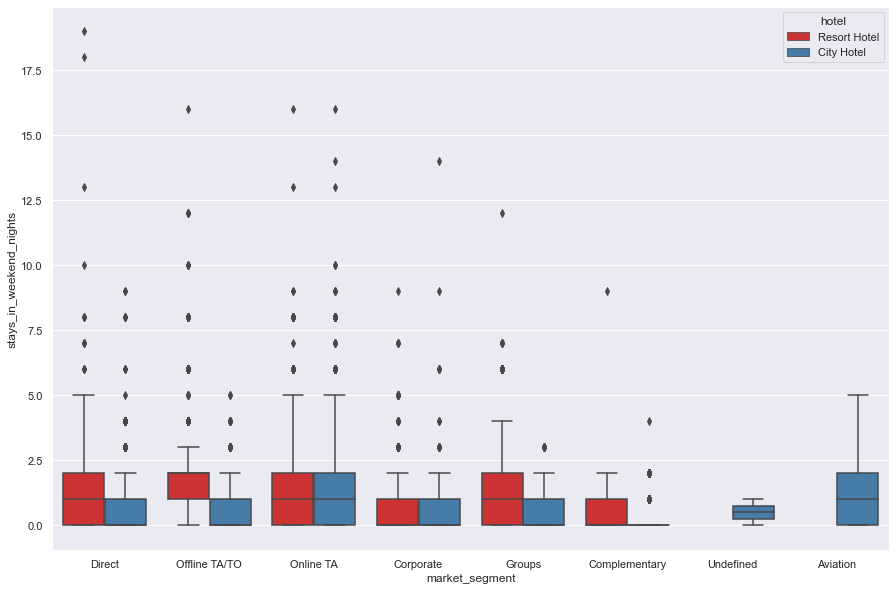

In [7]:
plt.figure(figsize=(15,10))
sns.boxplot(x = "market_segment", y = "stays_in_weekend_nights", data = data, hue = "hotel", palette = 'Set1')

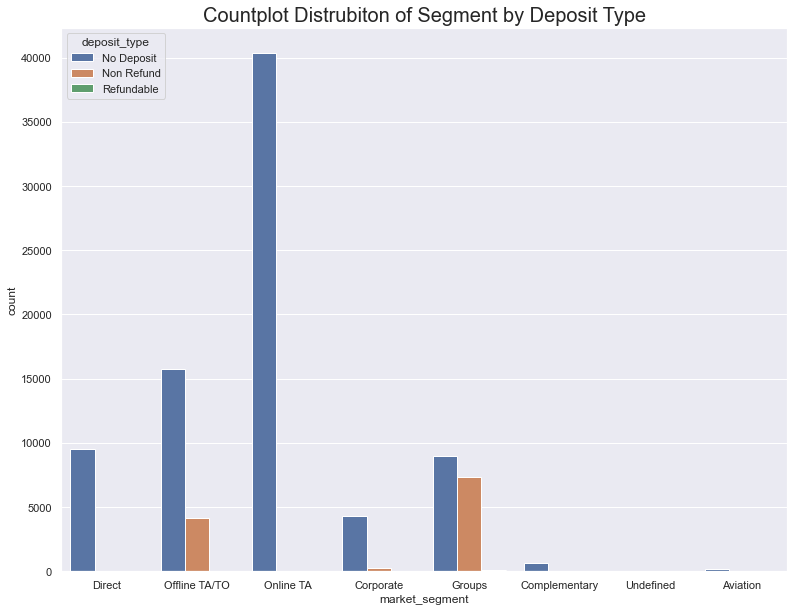

In [8]:
plt.figure(figsize = (13,10))
sns.set(style = "darkgrid")
plt.title("Countplot Distrubiton of Segment by Deposit Type", fontdict = {'fontsize':20})
ax = sns.countplot(x = "market_segment", hue = 'deposit_type', data = data)

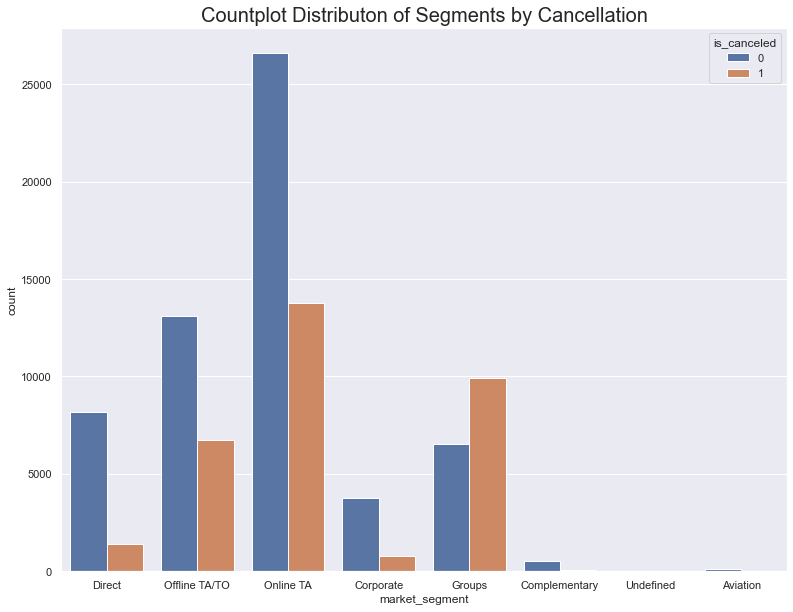

In [9]:
plt.figure(figsize = (13,10))
sns.set(style = "darkgrid")
plt.title("Countplot Distributon of Segments by Cancellation", fontdict = {'fontsize':20})
ax = sns.countplot(x = "market_segment", hue = 'is_canceled', data = data)

In [10]:
df_test = pd.read_csv('test.csv')
print("shape of train: " + str(df.shape))
print("shape of test: " + str(df_test.shape))

print("columns that do not exist in test data: " + str(list(set(list(df)) - set(list(df_test)))))

shape of train: (91531, 33)
shape of test: (27859, 29)
columns that do not exist in test data: ['adr', 'reservation_status', 'reservation_status_date', 'is_canceled']


## Country

In [11]:
import numpy as np
import plotly.express as px

country_data = pd.DataFrame(data.loc[data["is_canceled"] != np.nan]["country"].value_counts())
group_by_country = data.groupby(by='country')
country_data['cancel_rate'] = np.nan
country_data['average_adr'] = np.nan
# add the cancel rate for each country
for row in group_by_country['is_canceled'].mean().iteritems():
    country_data.loc[[row[0]], ['cancel_rate']] = row[1] # row[0] is country name, row[1] is the cancel rate
# add the average adr for each country
for row in group_by_country['adr'].mean().iteritems():
    country_data.loc[[row[0]], ['average_adr']] = row[1] # row[0] is country name, row[1] is the cancel rate

# show the canceled rate on map
guest_map = px.choropleth(country_data,
                    locations=country_data.index,
                    color=country_data["cancel_rate"], 
                    hover_name=country_data.index, 
                    color_continuous_scale=px.colors.sequential.Plasma,
                    title="Cancelation Rates over Countries")
guest_map.show()

# show the average adr on map
guest_map = px.choropleth(country_data,
                    locations=country_data.index,
                    color=country_data["average_adr"], 
                    hover_name=country_data.index, 
                    color_continuous_scale=px.colors.sequential.Plasma,
                    title="Average ADR over Countries")
guest_map.show()

## Data Correctness 

First, we matched the date difference (checkout - arrival) vs sum of week nights and found 23 rows un-matched. We drop all unmatched rows.

Then, we matched the columns is_canceled vs reservation_status and luckily they are all matched. We also confirmed that all no-show bookings are canceled.

In [12]:
# Add arrival_date column (year-month-day)
from datetime import datetime
from datetime import date

def combine_to_date(row):
    # year, month, day -> y-m-d
    return str(row['arrival_date_year']) + "-" \
    + str(row['arrival_date_month']) + "-" \
    + str(row['arrival_date_day_of_month'])
def str_to_datetime(input_date):
    return datetime.strptime(input_date,"%Y-%m-%d")
def calculate_date_diff(row):
    if row['reservation_status'] != 'Check-Out':
        return 0
    return float((str_to_datetime(str(row['reservation_status_date'])) - str_to_datetime(str(row['arrival_date']))).days)
def subtract_date_diff_and_week_nights(row):
    if row['reservation_status'] != 'Check-Out':
        return 0
    return float(row['date_diff'] - (row['stays_in_week_nights'] + row['stays_in_weekend_nights']))
def sum_all_nights(row):
    return float(row['stays_in_week_nights'] + row['stays_in_weekend_nights'])

In [13]:
# replace month with number
data['arrival_date_month'].replace({'January' : 1,
        'February' : 2,
        'March' : 3,
        'April' : 4,
        'May' : 5,
        'June' : 6,
        'July' : 7,
        'August' : 8,
        'September' : 9, 
        'October' : 10,
        'November' : 11,
        'December' : 12}, inplace=True)
data["arrival_date_month"] = pd.to_numeric(data["arrival_date_month"])

In [14]:
data['arrival_date'] = data.apply(combine_to_date, axis=1)

In [15]:
data['stays_in_week_nights'] + data['stays_in_weekend_nights']
data['date_diff'] = data.apply(calculate_date_diff, axis=1)
data['total_nights'] = data.apply(sum_all_nights, axis=1)
print("type of date diff is " + str(data['date_diff'].dtype))
print("number of date diff that is less than zero (should be 0): "+str(len(data[data['date_diff'] < 0])))

type of date diff is float64
number of date diff that is less than zero (should be 0): 0


number of data that the Date difference vs week nights are not matched: 23
number of rows left after dropping dates diff: 91508


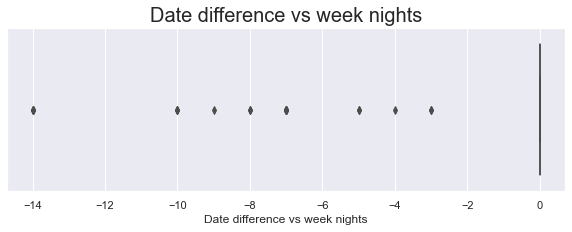

In [16]:
data['Date difference vs week nights'] = data.apply(subtract_date_diff_and_week_nights, axis=1)

plt.figure(figsize = (10,3))
sns.set(style = "darkgrid")
plt.title("Date difference vs week nights", fontdict = {'fontsize':20})
ax = sns.boxplot(x=data['Date difference vs week nights'])

tmp = data[data['Date difference vs week nights'] != 0]

print("number of data that the Date difference vs week nights are not matched: " + str(len(tmp)))

# drop all rows where date difference vs week nights != 0
data = data[data['Date difference vs week nights'] == 0]
print("number of rows left after dropping dates diff: " + str(len(data)))

In [17]:
print("number of unmatched cancel status: " + str(len(data[(data['is_canceled'] == 0) & (data['reservation_status'] == 'Canceled')])))
print("check if all no-show bookings are canceled (should be 0): "+ str(len(data[(data['is_canceled'] == 0) & (data['reservation_status'] == 'No-Show')])))


number of unmatched cancel status: 0
check if all no-show bookings are canceled (should be 0): 0


In [18]:
# Negative value is possible so don't drop it (reimbursement)
# print("number of ADR that is negative (we should drop this since ADR should not be negative): " + str(len(data[data['adr'] < 0])))

# # drop all negative ADR
# data = data[data['adr'] >= 0]
# print("number of rows left after dropping negative ADR: " + str(len(data)))

In [19]:
print("check when agent ID is nan\n")
print(data[(data['agent'].isnull())].groupby(by='customer_type').size())

print("\ncheck when company ID is nan\n")
print(data[(data['company'].isnull())].groupby(by='customer_type').size())

print("\ncheck when agent and company ID both are nan\n")
print(data[(data['agent'].isnull()) & (data['company'].isnull())].groupby(by='customer_type').size())

check when agent ID is nan

customer_type
Contract             13
Group                71
Transient          9260
Transient-Party    3871
dtype: int64

check when company ID is nan

customer_type
Contract            3459
Group                413
Transient          62868
Transient-Party    19156
dtype: int64

check when agent and company ID both are nan

customer_type
Contract             13
Group                43
Transient          5957
Transient-Party    1790
dtype: int64


## Make column value the same if possible  

In [20]:
# replace 'Undefined' with 'SC' since they both mean no meal package
data.loc[data['meal'] == 'Undefined', 'meal'] = 'SC'

## Removing invalid data

### Number of Children

In [21]:
print("number of rows that contains children number NaN: " + str(len(data[data['children'].isnull()])))

number of rows that contains children number NaN: 4


In [22]:
data[data['children'].isnull()][['is_canceled', 'adr', 'lead_time', 'arrival_date_year',
       'adults', 'children', 'babies', 'meal',
       'country', 'market_segment', 'distribution_channel',
       'is_repeated_guest', 'previous_cancellations',
       'previous_bookings_not_canceled', 'reserved_room_type',
       'assigned_room_type', 'booking_changes', 'deposit_type', 'agent',
       'company', 'days_in_waiting_list', 'customer_type',
       'required_car_parking_spaces', 'total_of_special_requests',
       'reservation_status', 'reservation_status_date', 'arrival_date',
       'date_diff', 'total_nights', 'Date difference vs week nights']]

,is_canceled,adr,lead_time,arrival_date_year,adults,children,babies,meal,country,market_segment,...,days_in_waiting_list,customer_type,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date,arrival_date,date_diff,total_nights,Date difference vs week nights
3075,1,32.417319,2,2015,2,NaN,0,BB,PRT,Undefined,...,0,Transient-Party,0,1,Canceled,2015-08-01,2015-8-3,0.0,1.0,0.0
3302,1,14.607883,1,2015,3,NaN,0,BB,PRT,Undefined,...,0,Transient-Party,0,2,Canceled,2015-08-04,2015-8-5,0.0,2.0,0.0
3307,1,6.631176,1,2015,2,NaN,0,BB,PRT,Direct,...,0,Transient-Party,0,1,Canceled,2015-08-04,2015-8-5,0.0,2.0,0.0
4350,1,80.210960,8,2015,2,NaN,0,BB,PRT,Online TA,...,0,Transient-Party,0,1,Canceled,2015-08-09,2015-8-13,0.0,7.0,0.0


In [23]:
# drop it
print("number of rows to drop: " + str(len(data[data['children'].isnull()])))
data = data[~data['children'].isnull()]
print("number of rows left after drop: " + str(len(data)))

number of rows to drop: 4
number of rows left after drop: 91504


### Losed Country Value

In [24]:
print("number of rows that contains country number NaN: " + str(len(data[data['country'].isnull()])))
print("number of rows to drop: " + str(len(data[data['country'].isnull()])))
data = data[~data['country'].isnull()]
print("number of rows left after drop: " + str(len(data)))

number of rows that contains country number NaN: 468
number of rows to drop: 468
number of rows left after drop: 91036


### Losed Agent Value

In [25]:
# don't drop agent of value nan! because the customer may book without the help of agents
# print("number of rows that contains agent number NaN: " + str(len(data[data['agent'].isnull()])))
# print("number of rows to drop: " + str(len(data[data['agent'].isnull()])))
# data = data[~data['agent'].isnull()]
# print("number of rows left after drop: " + str(len(data)))

## Removing outliers

### Number of Adults & Children

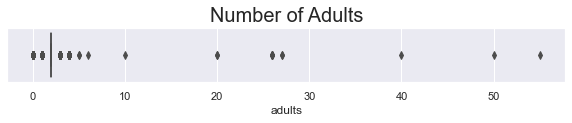

In [26]:
plt.figure(figsize = (10,1))
sns.set(style = "darkgrid")
plt.title("Number of Adults", fontdict = {'fontsize':20})
ax = sns.boxplot(x=data['adults'])

In [27]:
# This data is weird. A lot of adults but small ADR
print(data[data['adults'] > 20][['hotel','adr', 'adults', 'is_canceled']])

# drop it
data = data[data['adults'] < 20]
print("number of rows left after drop: " + str(len(data)))

              hotel        adr  adults  is_canceled
6994   Resort Hotel -60.875462      40            1
7471   Resort Hotel -48.139944      26            1
7756   Resort Hotel -23.418013      50            1
8532   Resort Hotel -36.636009      26            1
9911   Resort Hotel -24.031315      26            1
10132  Resort Hotel -54.478647      27            1
10744  Resort Hotel -45.975119      27            1
11283  Resort Hotel   2.496818      26            1
12129  Resort Hotel -58.751969      26            1
12484  Resort Hotel -15.625669      55            1
number of rows left after drop: 91024


In [28]:
# add one column that contains total number of people
def calculate_total_ppl(row):
    return row['adults'] + row['children'] + row['babies']
data['total_ppl'] = data.apply(calculate_total_ppl, axis=1)

# add one column that contains total cost per booking
def calculate_total_cost(row):
    if row['is_canceled'] == 1:
        return 0
    return row['adr'] * row['total_nights']
data['total_cost'] = data.apply(calculate_total_cost, axis=1)

### ADR

            hotel          adr  total_ppl  is_canceled
31980  City Hotel  5399.424061        2.0            1
number of rows left after drop: 91023


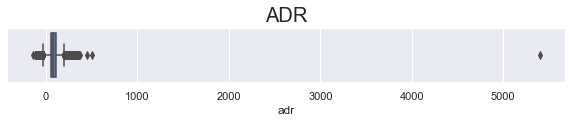

In [29]:
plt.figure(figsize = (10,1))
sns.set(style = "darkgrid")
plt.title("ADR", fontdict = {'fontsize':20})
ax = sns.boxplot(x=data['adr'])

# This data is weird. Only two people with extremely high ADR.
print(data[data['adr'] > 5000][['hotel','adr', 'total_ppl', 'is_canceled']])
# drop it
data = data[data['adr'] < 5000]
print("number of rows left after drop: " + str(len(data)))

           adr  children  adults  babies         hotel  is_canceled
864  72.825302      10.0       2       0  Resort Hotel            1
              adr  children  adults  babies         hotel arrival_date  \
864     72.825302      10.0       2       0  Resort Hotel    2015-7-12   
5049   165.702253       3.0       2       0  Resort Hotel    2015-8-17   
18997   87.872509       3.0       2       0  Resort Hotel   2015-11-28   
22037  122.306054       3.0       2       0  Resort Hotel     2016-1-1   
25768  149.740446       3.0       2       0  Resort Hotel    2016-2-13   
32519   89.501588       3.0       2       0  Resort Hotel    2016-3-29   
36838  120.249390       3.0       2       0  Resort Hotel    2016-4-23   
40909  139.978948       3.0       2       0  Resort Hotel    2016-5-15   
47958  167.683797       3.0       2       0  Resort Hotel    2016-6-23   
48799   93.385556       3.0       2       0  Resort Hotel    2016-6-28   
53581  216.441723       3.0       2       0  Resor

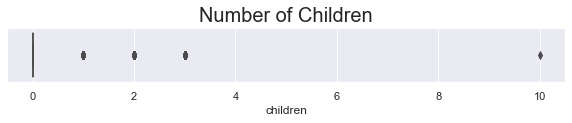

In [30]:
plt.figure(figsize = (10,1))
sns.set(style = "darkgrid")
plt.title("Number of Children", fontdict = {'fontsize':20})
ax = sns.boxplot(x=data['children'])

# This data is weird. There are 10 childrens and total ppl 12, but the ADR is less than total ppl 
print(data[data['children'] > 3][['adr', 'children', 'adults', 'babies', 'hotel', 'is_canceled']])
print(data[(data['adults'] == 2) & (data['babies'] == 0) & (data['hotel'] == 'Resort Hotel') & (data['children'] > 2)][['adr', 'children', 'adults', 'babies', 'hotel', 'arrival_date', 'is_canceled']])

### Total Cost

In [31]:
# This type of data with total cost 0 and is not canceled is also weird (check in and out on the same day)
print(data[(data['total_cost'] == 0) & (data['is_canceled'] == 0)])

# drop it 
print("number of rows dropped: " + str(len(data[(data['total_cost'] == 0) & (data['is_canceled'] == 0)])))
data = data[~((data['total_cost'] == 0) & (data['is_canceled'] == 0))]
print("number of rows left after drop: " + str(len(data)))

          ID         hotel  is_canceled  lead_time  arrival_date_year  \
0          0  Resort Hotel            0        342               2015   
119      119  Resort Hotel            0        737               2015   
472      472  Resort Hotel            0          0               2015   
473      473  Resort Hotel            0        111               2015   
517      517  Resort Hotel            0          8               2015   
...      ...           ...          ...        ...                ...   
90370  90370    City Hotel            0          0               2017   
91118  91118    City Hotel            0         64               2017   
91126  91126    City Hotel            0         41               2017   
91177  91177    City Hotel            0          9               2017   
91178  91178    City Hotel            0          0               2017   

       arrival_date_month  arrival_date_week_number  \
0                       7                        27   
119          

### Days in waiting list

wait > 250 days:

is_canceled
0    30
1    55
dtype: int64

--- 
wait > 350 days:

is_canceled
0     6
1    54
dtype: int64


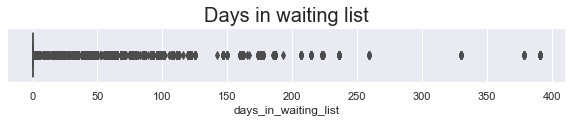

In [32]:
# see if days in waiting list contains outliers (maybe not)
plt.figure(figsize = (10,1))
sns.set(style = "darkgrid")
plt.title("Days in waiting list", fontdict = {'fontsize':20})
ax = sns.boxplot(x=data['days_in_waiting_list'])

print('wait > 250 days:\n')
print(data[data['days_in_waiting_list'] > 250].groupby(by='is_canceled').size())
print('\n--- \nwait > 350 days:\n')
print(data[data['days_in_waiting_list'] > 350].groupby(by='is_canceled').size())

### Zero People but Nonzero cost

In [33]:
print("number of data with total 0 people but total cost is not 0: " + str(len(data[(data['total_ppl'] == 0) & (data['total_cost'] > 0)])))

# drop it
print("number of rows to drop: " + str(len(data[(data['total_ppl'] == 0) & (data['total_cost'] > 0)])))
data = data[~((data['total_ppl'] == 0) & (data['total_cost'] > 0))]
print("number of rows left after drop: " + str(len(data)))

number of data with total 0 people but total cost is not 0: 50
number of rows to drop: 50
number of rows left after drop: 90349


### Negative Cost

      arrival_date   total_cost  total_nights  total_ppl
23816    2016-1-26 -4773.899519          42.0        2.0
52440    2016-7-23 -5675.441360          48.0        2.0
79800    2017-1-10 -4192.638020          56.0        2.0
84648    2017-2-17 -4250.216013          42.0        2.0


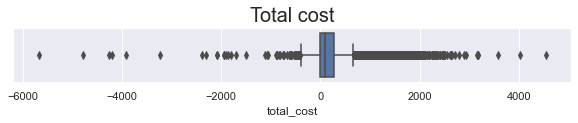

In [34]:
plt.figure(figsize = (10,1))
sns.set(style = "darkgrid")
plt.title("Total cost", fontdict = {'fontsize':20})
ax = sns.boxplot(x=data['total_cost'])

# These data are weird
print(data[data['total_cost'] < -4000][['arrival_date', 'total_cost', 'total_nights', 'total_ppl']])
# drop it??

To see if these data influenced the total revenue significantly, we first need to compute the revenue for each day:

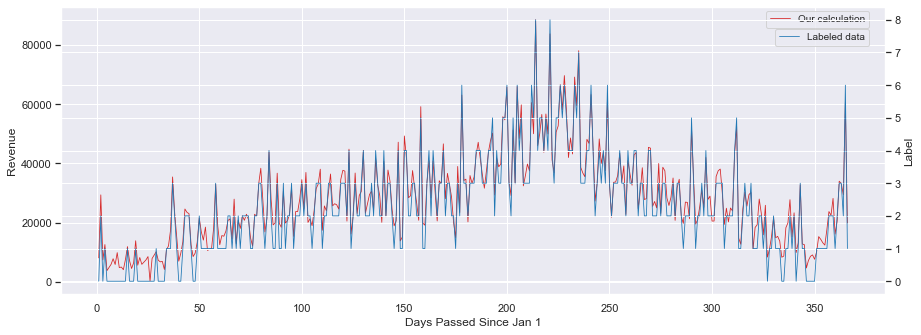

In [35]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from datetime import datetime
from datetime import date
from tensorflow import keras
from tensorflow import keras
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error


raw_train_data = pd.read_csv("./train.csv")
raw_test_data = pd.read_csv("./test.csv")
train_data = raw_train_data.copy()

# extract some informations that are useful to compute revenue
adr_df = raw_train_data[['arrival_date_year', 
                         'arrival_date_month',
                         'arrival_date_day_of_month',
                         'adr', 
                         'stays_in_weekend_nights',
                         'stays_in_week_nights',
                         'is_canceled',
                         'deposit_type',
                         'reservation_status_date']].copy()
# month names converted to the numbers
adr_df['arrival_date_month'].replace({'January' : '1',
        'February' : '2',
        'March' : '3',
        'April' : '4',
        'May' : '5',
        'June' : '6',
        'July' : '7',
        'August' : '8',
        'September' : '9', 
        'October' : '10',
        'November' : '11',
        'December' : '12'}, inplace=True)
adr_df['arrival_date'] = "" # format: y-m-d

def combine_to_date(row):
    # year, month, day -> y-m-d
    return str(row['arrival_date_year']) + "-" \
    + str(row['arrival_date_month']) + "-" \
    + str(row['arrival_date_day_of_month'])

def stay_nights_sum(row):
    return row['stays_in_weekend_nights'] + row['stays_in_week_nights']

# additional informations
adr_df['arrival_date'] = adr_df.apply(combine_to_date, axis=1)
adr_df['tm_yday'] = adr_df['arrival_date'].apply(lambda input_date: datetime.strptime(input_date,"%Y-%m-%d").timetuple().tm_yday)
adr_df['tm_wday'] = adr_df['arrival_date'].apply(lambda input_date: datetime.strptime(input_date,"%Y-%m-%d").timetuple().tm_wday)
adr_df['stay_nights'] = adr_df.apply(stay_nights_sum, axis=1)


def compute_revenue_and_plot():
    # compute the revenue
    # this dataframe is used to store the revenue for each day
    revenue_df = pd.DataFrame(columns=['arrival_date', 'revenue', 'year', 'month', 'month_day', 'tm_yday'])
    def compute_single_venue(row):
        adr = row['adr']
        nights = row['stay_nights']
        is_canceled = row['is_canceled']
        if not is_canceled:
            return adr * nights
        else:
            return 0
    revenue_df.set_index = revenue_df['arrival_date']
    for index, row in adr_df.iterrows():
        if row['arrival_date'] not in revenue_df.index.values:
            # create the new row
            new_row = pd.DataFrame()
            new_row['arrival_date'] = [row['arrival_date']]
            new_row['revenue'] = [compute_single_venue(row)]
            new_row['year'] = [row['arrival_date_year']]
            new_row['month'] = [row['arrival_date_month']]
            new_row['month_day'] = [row['arrival_date_day_of_month']]
            new_row['tm_yday'] = new_row['arrival_date'].apply(lambda input_date: datetime.strptime(input_date,"%Y-%m-%d").timetuple().tm_yday)
            # append the row into the revenue dataframe
            new_row.index = new_row['arrival_date']
            revenue_df = pd.concat([revenue_df, new_row])
        else:
            revenue_df.loc[row['arrival_date'], 'revenue'] += [compute_single_venue(row)]

    label_data = pd.read_csv("train_label.csv")

    def date_to_numbers(date):
        # return year, month, date
        year, month, date = [int(word) for word in date.split('-')]
        return year, month, date

    # add additional columns for plotting
    label_data['year'] = 0
    label_data['month'] = 0
    label_data['month_day'] = 0
    label_data[['year', 'month', 'month_day']] = [attr for attr in label_data["arrival_date"].apply(date_to_numbers)]
    label_data['tm_yday'] = label_data['arrival_date'].apply(lambda input_date: datetime.strptime(input_date,"%Y-%m-%d").timetuple().tm_yday)
    label_data['tm_wday'] = label_data['arrival_date'].apply(lambda input_date: datetime.strptime(input_date,"%Y-%m-%d").timetuple().tm_wday)
    fig, ax1 = plt.subplots(figsize=(13, 5))

    year_2016_idx = revenue_df['year'] == 2016
    year_2016_revenue = revenue_df[year_2016_idx].sort_values(by='tm_yday')
    year_2016_idx = label_data['year'] == 2016
    year_2016_label = label_data[year_2016_idx].sort_values(by='tm_yday')

    linewidth = 0.8
    color = 'tab:red'
    ax1.set_xlabel('Days Passed Since Jan 1')
    ax1.set_ylabel('Revenue')
    plot1 = ax1.plot(year_2016_revenue['tm_yday'], year_2016_revenue['revenue'],'-', linewidth=linewidth, color=color, label='Our calculation')
    ax1.tick_params(axis='y')
    ax1.legend(bbox_to_anchor=(0.94,0.93),bbox_transform=plt.gcf().transFigure,prop={'size': 10})

    ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis

    color = 'tab:blue'
    ax2.set_ylabel('Label')  # we already handled the x-label with ax1
    plot2 = ax2.plot(year_2016_label['tm_yday'], year_2016_label['label'],'-',linewidth=linewidth ,color=color, label='Labeled data')
    ax2.tick_params(axis='y')
    ax2.legend(bbox_to_anchor=(0.94,0.88),bbox_transform=plt.gcf().transFigure,prop={'size': 10})

    fig.tight_layout()  # otherwise the right y-label is slightly clipped
    plt.savefig("img/rev_formula2.png")
    plt.show()
    return revenue_df

revenue_df = compute_revenue_and_plot()

In [36]:
# the revenue in '2016-1-26' is nearly zero! It's obvious a outlier in the plot above.
print(revenue_df.loc[['2016-1-26', '2016-7-23', '2017-1-10', '2017-2-17']])

          arrival_date       revenue  year month month_day tm_yday
2016-1-26    2016-1-26    183.356304  2016     1        26      26
2016-7-23    2016-7-23  65968.695126  2016     7        23     205
2017-1-10    2017-1-10   6247.731642  2017     1        10      10
2017-2-17    2017-2-17  21695.180670  2017     2        17      48


Arrival Date Since 1/1

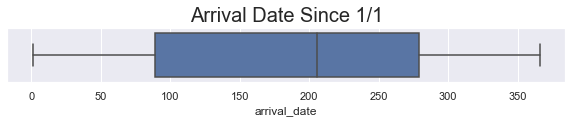

In [37]:
plt.figure(figsize = (10,1))
sns.set(style = "darkgrid")
plt.title("Arrival Date Since 1/1", fontdict = {'fontsize':20})
ax = sns.boxplot(x=data['arrival_date'].apply(lambda input_date: datetime.strptime(input_date,"%Y-%m-%d").timetuple().tm_yday))

## Make sure all data values are as expected 

In [38]:
print("All hotel is Resort Hotel or City Hotel: "+ str(len(data[~data['hotel'].isin(['Resort Hotel', 'City Hotel'])]) == 0))
print("All is_canceled is 0 or 1: "+ str(len(data[~data['is_canceled'].isin([0, 1])]) == 0))
print("All lead_time is above 0: "+ str(len(data[~data['lead_time'] >= 0]) == 0))
print("All arrival_date_year is 2015 / 2016 / 2017: "+ str(len(data[~data['arrival_date_year'].isin([2015, 2016, 2017])]) == 0))
print("All arrival_date_month is from 1 to 12: "+ str(len(data[~data['arrival_date_month'].isin(list(range(1, 13)))]) == 0))
print("All arrival_date_week_number is from 1 to 53: "+ str(len(data[~data['arrival_date_week_number'].isin(list(range(1, 54)))]) == 0))
print("All arrival_date_day_of_month is from 1 to 31: "+ str(len(data[~data['arrival_date_day_of_month'].isin(list(range(1, 32)))]) == 0))
print("All stays_in_weekend_nights is from 0 to 19: "+ str(len(data[~data['stays_in_weekend_nights'].isin(list(range(0, 20)))]) == 0))
print("All stays_in_week_nights is from 0 to 50: "+ str(len(data[~data['stays_in_week_nights'].isin(list(range(0, 51)))]) == 0))
print("All adults is from 0 to 4: "+ str(len(data[~data['adults'].isin(list(range(0, 5)))]) == 0))
print("All children is from 0 to 10: "+ str(len(data[~data['children'].isin(list(range(0, 11)))]) == 0))
print("All babies is from 0 to 10: "+ str(len(data[~data['babies'].isin(list(range(0, 11)))]) == 0))
print("All meal: " + str(data['meal'].unique()))
print("All country is within country list: "+ str(len(data[~data['country'].isin(['PRT', 'IRL', 'GBR', 'ESP', 'USA', 'FRA', 'ARG', 'OMN', 'NOR',
       'DEU', 'ROU', 'POL', 'ITA', 'BRA', 'BEL', 'CHE', 'CN', 'NLD',
       'GRC', 'DNK', 'SWE', 'RUS', 'EST', 'AUS', 'CZE', 'FIN', 'AUT',
       'ISR', 'HUN', 'MOZ', 'BWA', 'NZL', 'LUX', 'IDN', 'SVN', 'ALB',
       'MAR', 'HRV', 'CHN', 'AGO', 'BGR', 'IND', 'DZA', 'MEX', 'TUN',
       'COL', 'KAZ', 'LVA', 'STP', 'UKR', 'VEN', 'TWN', 'IRN', 'SMR',
       'TUR', 'KOR', 'BLR', 'JPN', 'PRI', 'SRB', 'LTU', 'CPV', 'AZE',
       'LBN', 'CRI', 'CHL', 'THA', 'SVK', 'CMR', 'EGY', 'LIE', 'MYS',
       'SAU', 'ZAF', 'MKD', 'MMR', 'DOM', 'IRQ', 'SGP', 'CYM', 'ZMB',
       'PAN', 'ZWE', 'SEN', 'NGA', 'GIB', 'ARM', 'PER', 'LKA', 'KWT',
       'JOR', 'KNA', 'GEO', 'TMP', 'ETH', 'ECU', 'MUS', 'PHL', 'CUB',
       'ARE', 'BFA', 'AND', 'CYP', 'KEN', 'BIH', 'COM', 'SUR', 'JAM',
       'HND', 'MCO', 'GNB', 'LBY', 'RWA', 'PAK', 'UGA', 'CIV', 'SYR',
       'QAT', 'KHM', 'HKG', 'BGD', 'MLI', 'ISL', 'TZA', 'UZB', 'BHR',
       'URY', 'NAM', 'BOL', 'IMN', 'BDI', 'TJK', 'MLT', 'MDV', 'NIC',
       'SYC', 'PRY', 'BRB', 'ABW', 'GGY', 'AIA', 'VNM', 'SLV', 'PLW',
       'BEN', 'MAC', 'DMA', 'VGB', 'JEY', 'GAB', 'PYF', 'CAF', 'LCA',
       'GUY', 'ATA', 'GHA', 'MWI', 'MNE', 'GLP', 'GTM', 'MDG', 'ASM',
       'TGO'])]) == 0))
print("All market_segment: " + str(data['market_segment'].unique()))
print("All distribution_channel: " + str(data['distribution_channel'].unique()))
print("All is_repeated_guest: " + str(data['is_repeated_guest'].unique()))
print("All previous_cancellations is from 0 to 26: "+ str(len(data[~data['previous_cancellations'].isin(list(range(0, 27)))]) == 0))
print("All previous_bookings_not_canceled is from 0 to 61: "+ str(len(data[~data['previous_bookings_not_canceled'].isin(list(range(0, 62)))]) == 0))
print("All reserved_room_type: " + str(data['reserved_room_type'].unique()))
print("All assigned_room_type: " + str(data['assigned_room_type'].unique()))
print("All booking_changes is from 0 to 17: "+ str(len(data[~data['booking_changes'].isin(list(range(0, 18)))]) == 0))
print("All deposit_type: " + str(data['deposit_type'].unique()))
# skip 'agent' column
# skip 'company' column
print("All days_in_waiting_list is from 0 to 391: "+ str(len(data[~data['days_in_waiting_list'].isin(list(range(0, 392)))]) == 0))
print("All adr is from -145 to 505: "+ str(data['adr'].max() <= 505 and data['adr'].min() >= -145))
print("All required_car_parking_spaces: " + str(data['required_car_parking_spaces'].unique()))
print("All total_of_special_requests: " + str(data['total_of_special_requests'].unique()))
print("All reservation_status: " + str(data['reservation_status'].unique()))
print("All reservation_status_date is from " + str(data['reservation_status_date'].min()) + " to " + str(data['reservation_status_date'].max()))
print("All arrival_date is from " + str(data['arrival_date'].min()) + " to " + str(data['arrival_date'].max()))
print("All total_cost is from " + str(data['total_cost'].min()) + " to " + str(data['total_cost'].max()))
print("All total_ppl is from " + str(data['total_ppl'].min()) + " to " + str(data['total_ppl'].max()))
print("All total_nights is from " + str(data['total_nights'].min()) + " to " + str(data['total_nights'].max()))

All hotel is Resort Hotel or City Hotel: True
All is_canceled is 0 or 1: True
All lead_time is above 0: True
All arrival_date_year is 2015 / 2016 / 2017: True
All arrival_date_month is from 1 to 12: True
All arrival_date_week_number is from 1 to 53: True
All arrival_date_day_of_month is from 1 to 31: True
All stays_in_weekend_nights is from 0 to 19: True
All stays_in_week_nights is from 0 to 50: True
All adults is from 0 to 4: False
All children is from 0 to 10: True
All babies is from 0 to 10: True
All meal: ['HB' 'BB' 'FB' 'SC']
All country is within country list: True
All market_segment: ['Offline TA/TO' 'Online TA' 'Corporate' 'Direct' 'Groups' 'Complementary'
 'Aviation']
All distribution_channel: ['TA/TO' 'Corporate' 'Direct' 'Undefined' 'GDS']
All is_repeated_guest: [0 1]
All previous_cancellations is from 0 to 26: True
All previous_bookings_not_canceled is from 0 to 61: True
All reserved_room_type: ['A' 'D' 'E' 'F' 'G' 'C' 'H' 'B' 'L']
All assigned_room_type: ['A' 'C' 'E' 'B' '

## Find relationship between total cost per booking and other variables

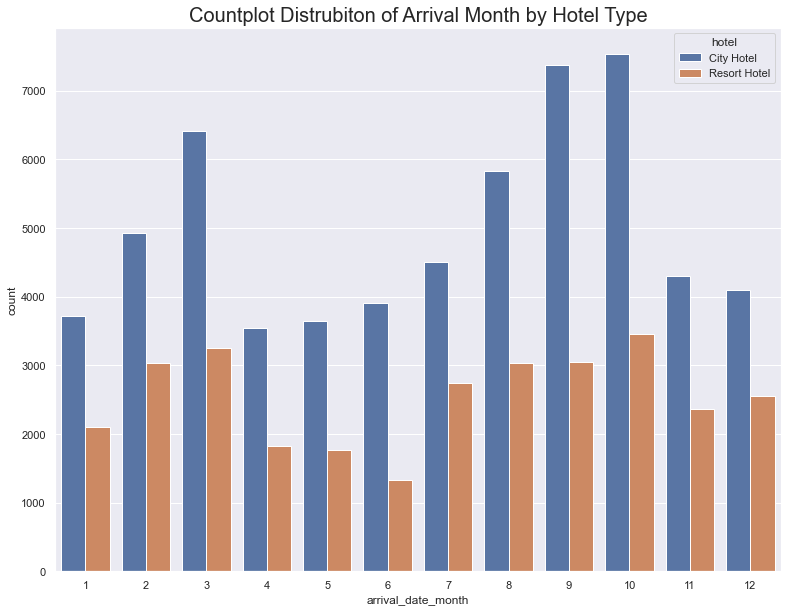

In [39]:
plt.figure(figsize = (13,10))
sns.set(style = "darkgrid")
plt.title("Countplot Distrubiton of Arrival Month by Hotel Type", fontdict = {'fontsize':20})
ax = sns.countplot(x = "arrival_date_month", hue = 'hotel', data = data)

In [40]:
month_to_total_bookings = data.groupby(by='arrival_date_month').size()
month_to_total_bookings

arrival_date_month
1      5822
2      7956
3      9669
4      5378
5      5401
6      5248
7      7256
8      8875
9     10426
10    10996
11     6676
12     6646
dtype: int64

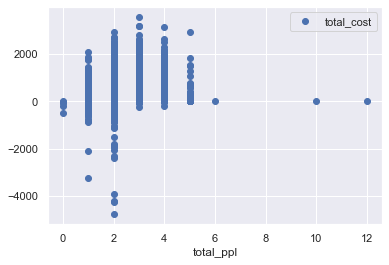

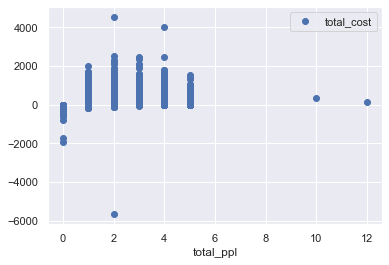

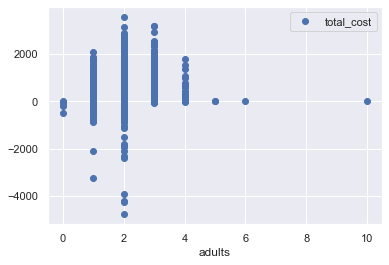

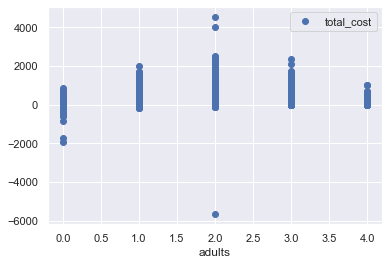

In [41]:
# show correlation of total_ppl and ADR

# for resort hotel
data[data['hotel'] == 'Resort Hotel'].plot(x='total_ppl', y='total_cost', style='o')

# for city hotel
data[data['hotel'] == 'City Hotel'].plot(x='total_ppl', y='total_cost', style='o')

# show correlation of adults and ADR

# for resort hotel
data[data['hotel'] == 'Resort Hotel'].plot(x='adults', y='total_cost', style='o')

# for city hotel
data[data['hotel'] == 'City Hotel'].plot(x='adults', y='total_cost', style='o')

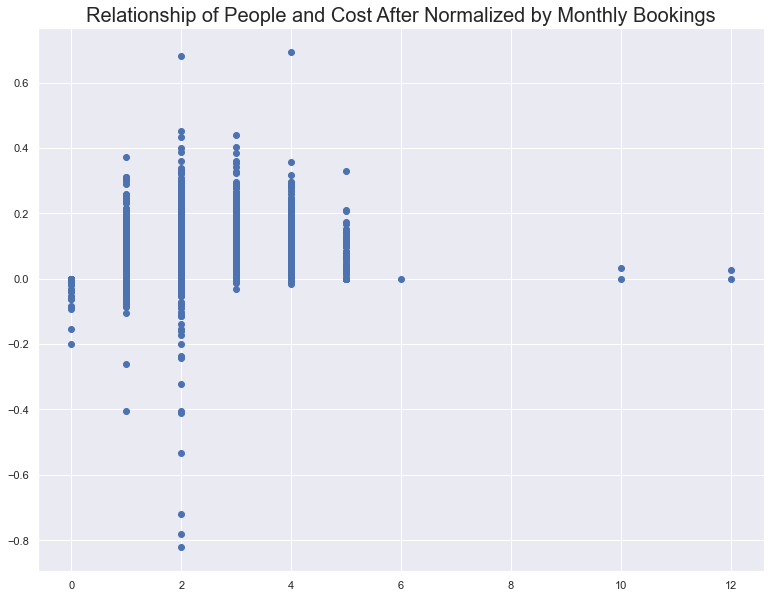

In [42]:
plt.figure(figsize = (13,10))
plt.title("Relationship of People and Cost After Normalized by Monthly Bookings", fontdict = {'fontsize':20})

def normalized_cost(row):
    return row['total_cost']/(month_to_total_bookings[row['arrival_date_month']])
# data.apply(normalized_cost, axis=1)

plt.scatter(data['total_ppl'], data.apply(normalized_cost, axis=1))